In [3]:
import os
import PIL
import cv2
from PIL import Image, ImageOps,ImageFilter
import numpy as np
import random
import math
from skimage import util 
import matplotlib.pyplot as plt
import numpy as np
from scipy import ndimage

## Import an image and check dimension and size 


the picture's dimensions are : (2050, 1305)
picture format : JPEG
picture size : 1013.337890625  kb
picture mode : RGB


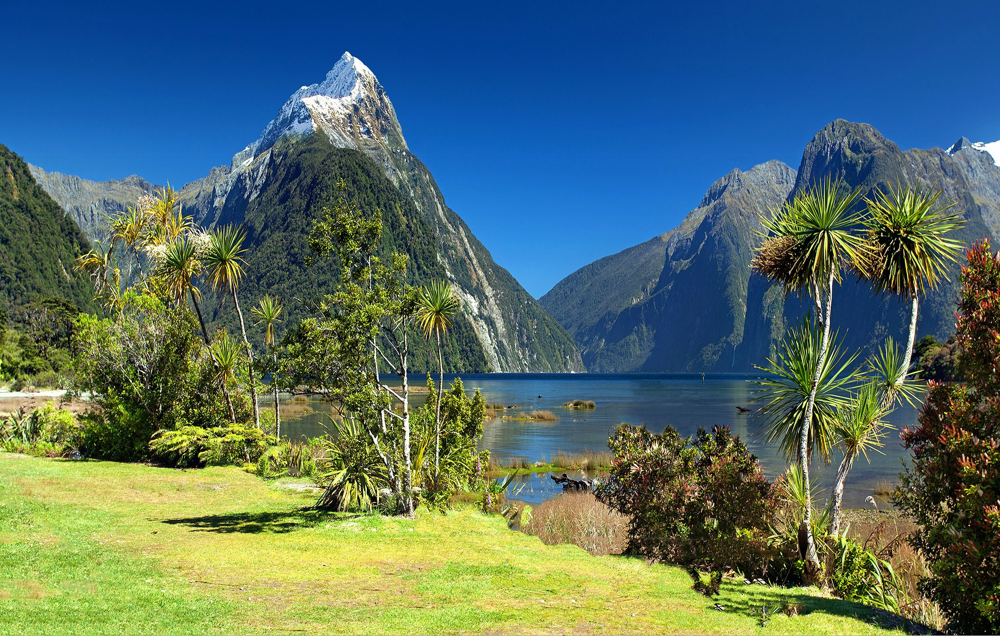

In [6]:
picture = Image.open('jpeg.jpeg')
print("the picture's dimensions are :",picture.size)
print("picture format :",picture.format)
print("picture size :",os.stat('jpeg.jpeg').st_size/1024," kb")
print("picture mode :",picture.mode)
picture

## Convert an image to gray mode 

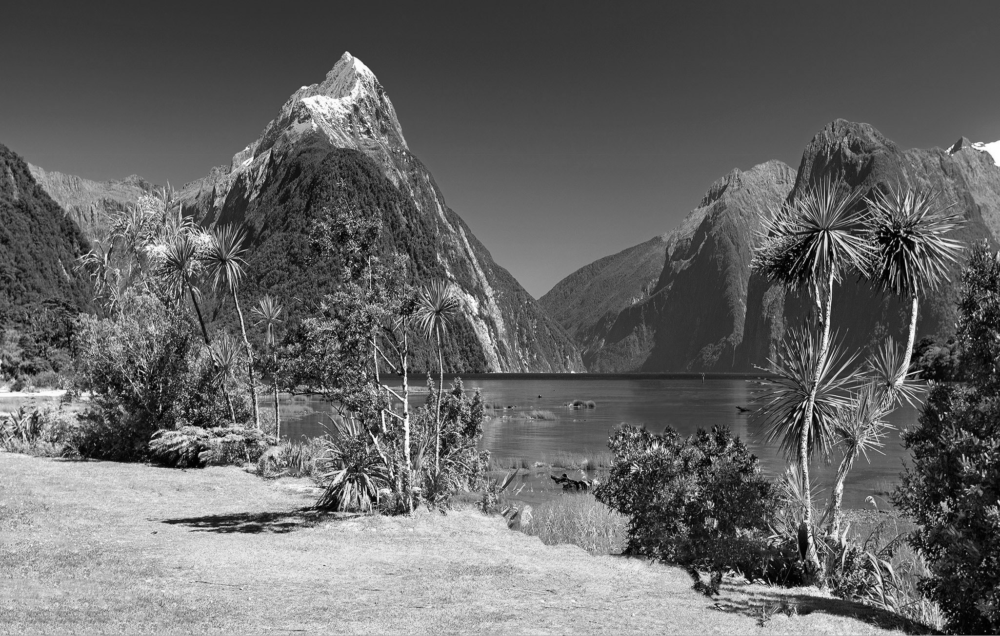

In [7]:
gray_picture = picture.convert('L')
gray_picture

## Apply a high pass filter to the picture 


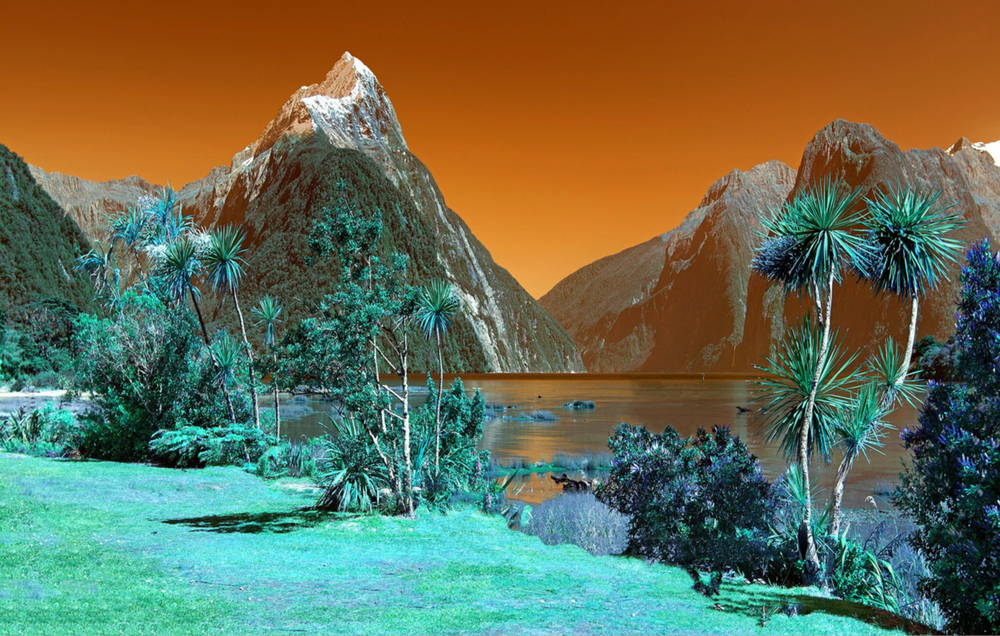

In [25]:
import cv2

picture_cv = cv2.imread('jpeg.jpeg')
kernel = np.array([[1, 1, 1],
                   [1, 1, 1],
                   [1, 1, 1]])
kernel1=kernel*1/9
picture_array = cv2.filter2D(picture_cv,-1,kernel1)
image_filtre = Image.fromarray(picture_array, 'RGB')
image_filtre

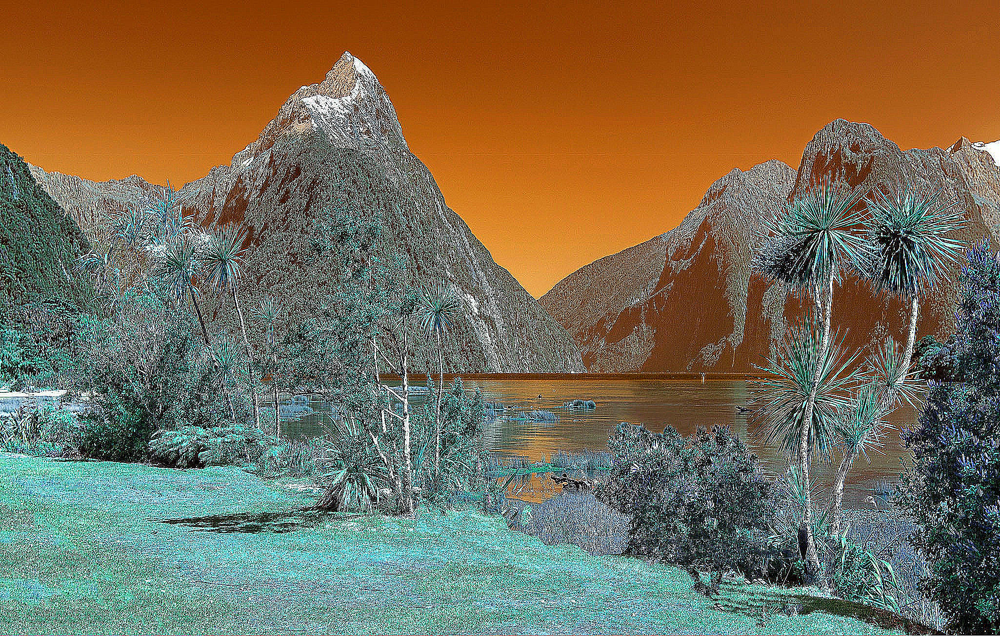

In [26]:
kernel = np.array([[-1, -1, -1],
                   [-1,  9, -1],
                   [-1, -1, -1]])

picture_array = cv2.filter2D(picture_cv,-1,kernel)
image_filtre = Image.fromarray(picture_array, 'RGB')
image_filtre

## apply a sobel filter 

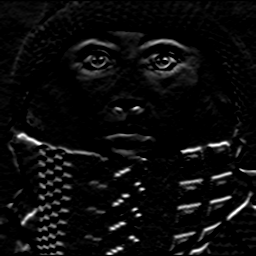

In [31]:

gray_picture = cv2.imread('trui.png',cv2.IMREAD_GRAYSCALE)
noise_picture = cv2.GaussianBlur(gray_picture,(3,3),0)
kernelx = np.array([[-1, 0, 1],
                   [-2, 0, 2],
                   [-1, 0, 1]])


noise_filter_x = cv2.filter2D(noise_picture,-1,kernelx)
image_filtre_x = Image.fromarray(noise_filter, 'L')
image_filtre_x

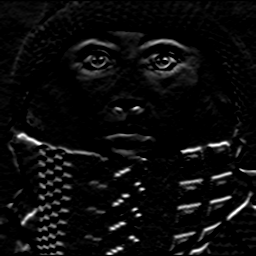

In [32]:
##filtre sobel

gray_picture = cv2.imread('trui.png',cv2.IMREAD_GRAYSCALE)
noise_picture = cv2.GaussianBlur(gray_picture,(3,3),0)
kernely = np.array([[-1, -2, -1],
                   [0, 0, 0],
                   [1, 2, 1]])


noise_filter_y = cv2.filter2D(noise_picture,-1,kernely)
image_filtre_y = Image.fromarray(noise_filter, 'L')
image_filtre_y





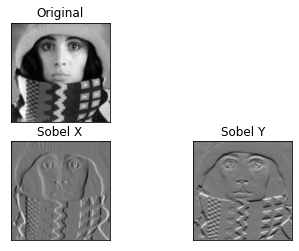

In [30]:
from matplotlib import pyplot as plt

# loading image
picture = cv2.imread('trui.png',)

# converting to gray scale
gray_picture = cv2.cvtColor(picture, cv2.COLOR_BGR2GRAY)

# remove noise
picture = cv2.GaussianBlur(gray_picture,(3,3),0)

# convolute with proper kernels
laplacian = cv2.Laplacian(picture,cv2.CV_64F)
sobelx = cv2.Sobel(picture,cv2.CV_64F,1,0,ksize=5)  # x
sobely = cv2.Sobel(picture,cv2.CV_64F,0,1,ksize=5)  # y

plt.subplot(2,2,1),plt.imshow(picture,cmap = 'gray')
plt.title('Original'), plt.xticks([]), plt.yticks([])
# plt.subplot(2,2,2),plt.imshow(laplacian,cmap = 'gray')
# plt.title('Laplacian'), plt.xticks([]), plt.yticks([])
plt.subplot(2,2,3),plt.imshow(sobelx,cmap = 'gray')
plt.title('Sobel X'), plt.xticks([]), plt.yticks([])
plt.subplot(2,2,4),plt.imshow(sobely,cmap = 'gray')
plt.title('Sobel Y'), plt.xticks([]), plt.yticks([])

plt.show()

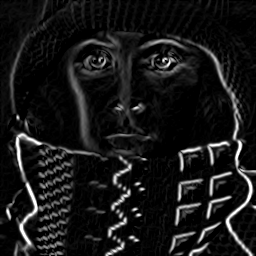

In [33]:
nouv_im=np.maximum(np.array(noise_filter_x),np.array(noise_filter_y))
image_ = Image.fromarray(nouv_im, 'L')
image_

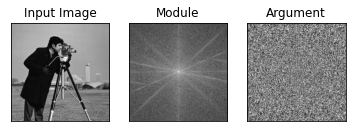

In [35]:
img = cv2.imread('cameraman.jpg',0)
f = np.fft.fft2(img)
fshift = np.fft.fftshift(f)
module = 20*np.log(np.abs(fshift))
argument = np.angle(fshift)
# print(argument)
plt.subplot(131),plt.imshow(img, cmap = 'gray')
plt.title('Input Image'), plt.xticks([]), plt.yticks([])
plt.subplot(132),plt.imshow(module, cmap = 'gray')
plt.title('Module'), plt.xticks([]), plt.yticks([])
plt.subplot(133),plt.imshow(argument, cmap = 'gray')
plt.title('Argument'), plt.xticks([]), plt.yticks([])
plt.show()

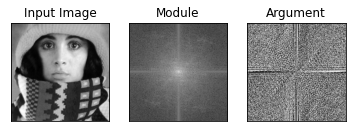

In [36]:
img = cv2.imread('trui.png',0)
f = np.fft.fft2(img)
fshift = np.fft.fftshift(f)
module1 = 20*np.log(np.abs(fshift))
argument1 = np.angle(fshift)
# print(argument)
plt.subplot(131),plt.imshow(img, cmap = 'gray')
plt.title('Input Image'), plt.xticks([]), plt.yticks([])
plt.subplot(132),plt.imshow(module1, cmap = 'gray')
plt.title('Module'), plt.xticks([]), plt.yticks([])
plt.subplot(133),plt.imshow(argument1, cmap = 'gray')
plt.title('Argument'), plt.xticks([]), plt.yticks([])
plt.show()

(Text(0.5, 1.0, 'Input Image'), ([], []), ([], []))

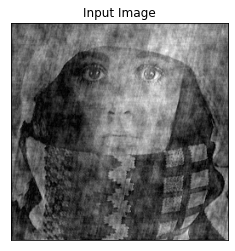

In [37]:
matrice_=np.multiply(np.exp(module/20),np.exp(argument1*1j))
# print(matrice_)
matrice_inverse=np.fft.ifft2(matrice_)
# print(matrice_inverse)
matrice__=np.abs(matrice_inverse)
plt.subplot(111),plt.imshow(matrice__, cmap = 'gray')
plt.title('Input Image'), plt.xticks([]), plt.yticks([])